In [60]:
import pandas as pd
import matplotlib.pyplot as mp
import seaborn as sns
import plotly.express as px
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.graphics.tsaplots import plot_pacf
from sktime.forecasting.naive import NaiveForecaster
import statsmodels.api as sm
from statsmodels.tsa.stattools import adfuller
from sktime.forecasting.base import ForecastingHorizon
from statsmodels.tsa.holtwinters import SimpleExpSmoothing
from statsmodels.tsa.holtwinters import ExponentialSmoothing

In [52]:
Dataset_WF_site1 = pd.read_excel(r'Wind farm site 1 (Nominal capacity-99MW).xlsx').drop(index=0)
Dataset_WF_site2 = pd.read_excel(r'Wind farm site 2 (Nominal capacity-200MW).xlsx').drop(index=0)
Dataset_WF_site3 = pd.read_excel(r'Wind farm site 3 (Nominal capacity-99MW).xlsx').drop(index=0)

In [3]:
Dataset_WF_site1.head()

,Time(year-month-day h:m:s),Wind speed at height of 10 meters (m/s),Wind direction at height of 10 meters (˚),Wind speed at height of 30 meters (m/s),Wind direction at height of 30 meters (˚),Wind speed at height of 50 meters (m/s),Wind direction at height of 50 meters (˚),Wind speed - at the height of wheel hub (m/s),Wind speed - at the height of wheel hub (˚),Air temperature (°C),Atmosphere (hpa),Relative humidity (%),Power (MW)
1,2019-01-01 00:15:00,1.828,77.460,1.698,75.048,1.757,88.733,1.882,74.367,-13.691,889.575,76.757,0.329703
2,2019-01-01 00:30:00,2.193,86.700,2.313,84.688,2.344,89.100,2.350,89.000,-13.766,889.942,76.981,0.296306
3,2019-01-01 00:45:00,2.654,78.160,2.494,74.939,2.574,87.267,2.808,82.733,-13.691,889.675,76.821,0.187590
4,2019-01-01 01:00:00,2.249,94.297,2.192,91.140,2.558,96.900,2.924,92.967,-13.447,890.025,74.571,0.081005
5,2019-01-01 01:15:00,1.974,92.933,1.980,91.921,2.049,97.000,2.137,100.133,-13.983,889.692,71.808,0.189721


In [22]:
Dataset_WF_site1.tail()

,Time(year-month-day h:m:s),Wind speed at height of 10 meters (m/s),Wind direction at height of 10 meters (˚),Wind speed at height of 30 meters (m/s),Wind direction at height of 30 meters (˚),Wind speed at height of 50 meters (m/s),Wind direction at height of 50 meters (˚),Wind speed - at the height of wheel hub (m/s),Wind speed - at the height of wheel hub (˚),Air temperature (°C),Atmosphere (hpa),Relative humidity (%),Power (MW)
70171,2020-12-31 22:45:00,5.738,234.600,6.408,235.454,6.575,242.033,6.680,238.433,-9.108,890.008,53.312,13.633642
70172,2020-12-31 23:00:00,5.748,229.333,6.231,233.423,6.372,239.800,6.448,236.833,-9.978,889.817,53.877,6.869759
70173,2020-12-31 23:15:00,4.468,235.133,4.406,253.261,4.381,263.400,4.399,261.733,-9.808,889.825,54.437,4.352931
70174,2020-12-31 23:30:00,3.730,242.580,3.280,252.492,3.204,268.600,3.446,266.733,-9.633,889.492,54.677,7.185250
70175,2020-12-31 23:45:00,3.291,243.733,3.311,254.267,3.643,266.733,4.306,268.633,-8.991,889.492,53.381,12.384466


In [4]:
Dataset_WF_site2.head()

,Time(year-month-day h:m:s),Wind speed at height of 10 meters (m/s),Wind direction at height of 10 meters (˚),Wind speed at height of 30 meters (m/s),Wind direction at height of 30 meters (˚),Wind speed at height of 50 meters (m/s),Wind direction at height of 50 meters (˚),Wind speed - at the height of wheel hub (m/s),Wind speed - at the height of wheel hub (˚),Air temperature (°C),Atmosphere (hpa),Power (MW)
1,2019-01-01 00:15:00,2.951,129.697,2.951,118.488,2.951,97.463,2.186,108.914,-12.992,887.227,36.811337
2,2019-01-01 00:30:00,2.951,124.756,3.563,118.210,2.798,91.528,2.492,97.322,-12.745,887.094,31.172535
3,2019-01-01 00:45:00,2.186,129.019,2.339,112.761,2.339,94.015,1.281,99.393,-12.904,887.214,27.836002
4,2019-01-01 01:00:00,2.033,121.358,1.880,105.626,2.186,99.392,2.186,95.703,-12.979,887.227,31.192802
5,2019-01-01 01:15:00,2.339,131.853,3.563,122.411,2.951,108.440,2.033,107.327,-12.772,887.107,35.726536


In [5]:
Dataset_WF_site3.head()

,Time(year-month-day h:m:s),Wind speed at height of 10 meters (m/s),Wind direction at height of 10 meters (˚),Wind speed at height of 30 meters (m/s),Wind direction at height of 30 meters (˚),Wind speed at height of 50 meters (m/s),Wind direction at height of 50 meters (˚),Wind speed - at the height of wheel hub (m/s),Wind speed - at the height of wheel hub (˚),Air temperature (°C),Atmosphere (hpa),Relative humidity (%),Power (MW)
1,2019-01-01 00:15:00,2.32218,317.431,2.59042,312.468,1.62735,351.117,2.34887,313.33,26.46,984.37,31.7949,-0.376874
2,2019-01-01 00:30:00,2.32218,317.431,2.59042,312.468,1.62735,351.117,2.34887,313.33,26.46,984.37,31.7949,-0.387959
3,2019-01-01 00:45:00,2.32218,317.431,2.59042,312.468,1.62735,351.117,2.34887,313.33,26.46,984.37,31.7949,-0.395348
4,2019-01-01 01:00:00,2.32218,317.431,2.59042,312.468,1.62735,351.117,2.34887,313.33,26.46,984.37,31.7949,-0.384264
5,2019-01-01 01:15:00,2.32218,317.431,2.59042,312.468,1.62735,351.117,2.34887,313.33,26.46,984.37,31.7949,-0.406433


In [6]:
Dataset_WF_site1.nunique()

Time(year-month-day h:m:s)                       70175
Wind speed at height of 10 meters (m/s)          13417
Wind direction at height of 10 meters (˚)        29353
Wind speed at height of 30 meters (m/s)          14628
Wind direction at height of 30 meters (˚)        58483
Wind speed at height of 50 meters (m/s)          15132
Wind direction at height of 50 meters (˚)        11665
Wind speed - at the height of wheel hub (m/s)    15194
Wind speed - at the height of wheel hub (˚)      11437
Air temperature  (°C)                            14852
Atmosphere (hpa)                                   835
Relative humidity (%)                            21638
Power (MW)                                       43877
dtype: int64

In [7]:
Dataset_WF_site2.nunique()

Time(year-month-day h:m:s)                        70175
Wind speed at height of 10 meters (m/s)            3266
Wind direction at height of 10 meters (˚)         50411
Wind speed at height of 30 meters (m/s)            3411
Wind direction at height of 30 meters (˚)         48979
Wind speed at height of 50 meters (m/s)            3387
Wind direction at height of 50 meters (˚)         48583
Wind speed - at the height of wheel hub  (m/s)     3580
Wind speed - at the height of wheel hub (˚)       49416
Air temperature  (°C)                             32569
Atmosphere (hpa)                                  16078
Power (MW)                                        60967
dtype: int64

In [8]:
Dataset_WF_site3.nunique()

Time(year-month-day h:m:s)                       70175
Wind speed at height of 10 meters (m/s)           5841
Wind direction at height of 10 meters (˚)        36925
Wind speed at height of 30 meters (m/s)           5242
Wind direction at height of 30 meters (˚)        37302
Wind speed at height of 50 meters (m/s)           8270
Wind direction at height of 50 meters (˚)        40959
Wind speed - at the height of wheel hub (m/s)     5319
Wind speed - at the height of wheel hub (˚)      37435
Air temperature  (°C)                            10937
Atmosphere (hpa)                                 14415
Relative humidity (%)                            49621
Power (MW)                                       21051
dtype: int64

In [9]:
px.line(Dataset_WF_site1, x='Time(year-month-day h:m:s)',y='Power (MW)')

In [10]:
px.line(Dataset_WF_site2, x='Time(year-month-day h:m:s)',y='Power (MW)')

In [11]:
px.line(Dataset_WF_site3, x='Time(year-month-day h:m:s)',y='Power (MW)')

## Doing analysis on WindFarm1

/var/folders/tl/_v6g46bs3cx9m65hytfp0q1w0000gp/T/ipykernel_75776/3076384628.py:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



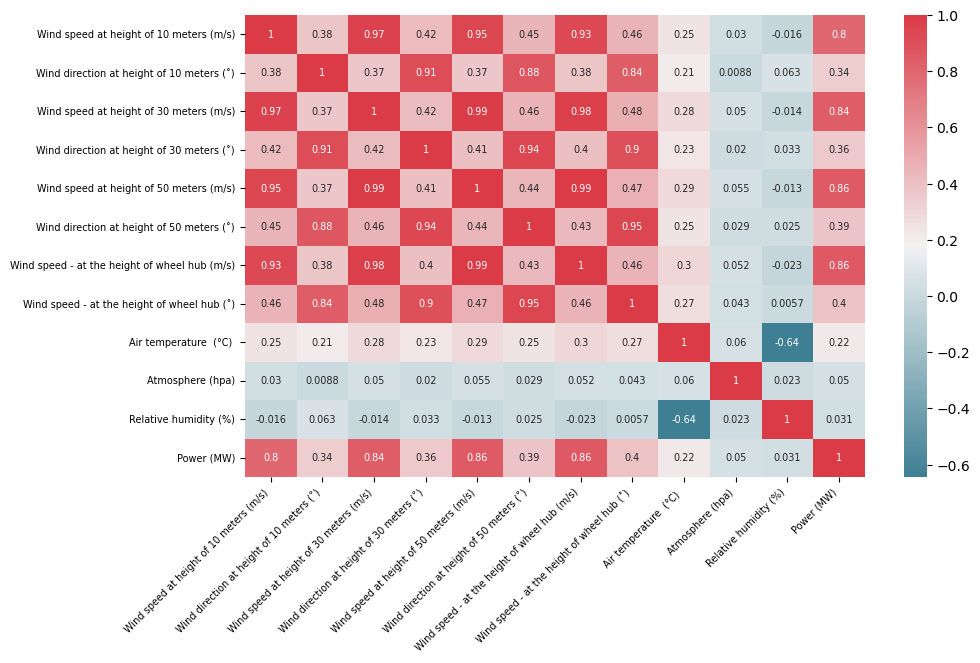

In [12]:
corr_matrix = Dataset_WF_site1.corr()
fig, ax = mp.subplots(figsize=(10, 6))
sns.heatmap(corr_matrix, 
            cmap=sns.diverging_palette(220, 10, as_cmap=True), 
            annot=True, 
            annot_kws={"fontsize":7}
           )
mp.xticks(rotation=45, ha='right', fontsize=7) 
mp.yticks(fontsize=7) 

mp.show()

In [13]:
Dataset_WF_site1.index

RangeIndex(start=1, stop=70176, step=1)

In [14]:
X = Dataset_WF_site1
corr_columns = set() # To get unique correlated column names
corr_matrix = X.corr()
for i in range(len(corr_matrix.columns)):
    for j in range(i):
        if abs(corr_matrix.iloc[i][j]) > 0.8 :    # Checking the absolute value of the corr coeff
            column_name = corr_matrix.columns[i]       # Getting the name of the column
            corr_columns.add(column_name)
corr_columns

/var/folders/tl/_v6g46bs3cx9m65hytfp0q1w0000gp/T/ipykernel_75776/2776910771.py:3: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



{'Power (MW)',
 'Wind direction at height of 30 meters (˚)',
 'Wind direction at height of 50 meters (˚)',
 'Wind speed - at the height of wheel hub (m/s)',
 'Wind speed - at the height of wheel hub (˚)',
 'Wind speed at height of 30 meters (m/s)',
 'Wind speed at height of 50 meters (m/s)'}

<Axes: >

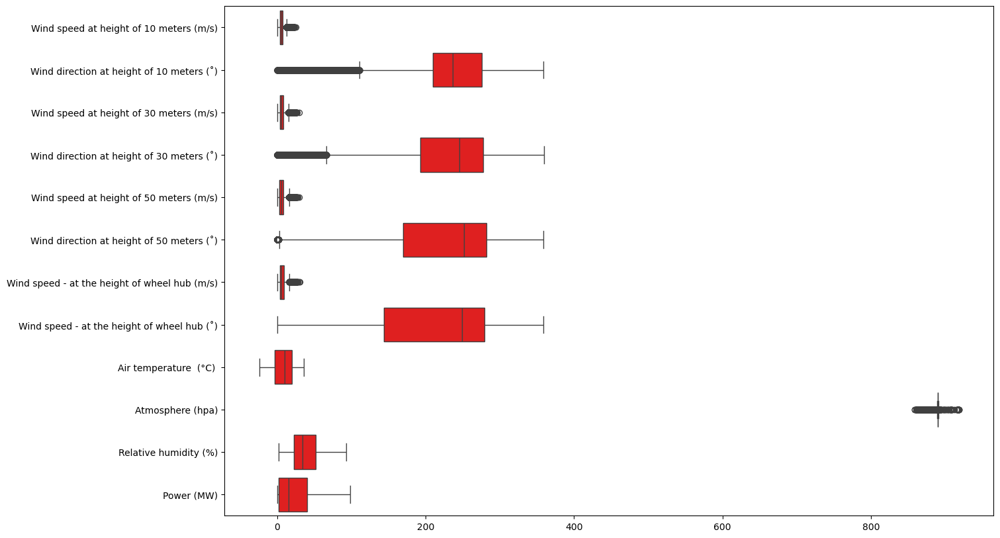

In [8]:
mp.figure(figsize=(15,10))
# X = Dataset_WF_site1.filter(regex='speed at')
# sns.boxplot(X, orient='h', color='turquoise', native_scale='true')
sns.boxplot(Dataset_WF_site1, orient='h', color='red', native_scale='true')

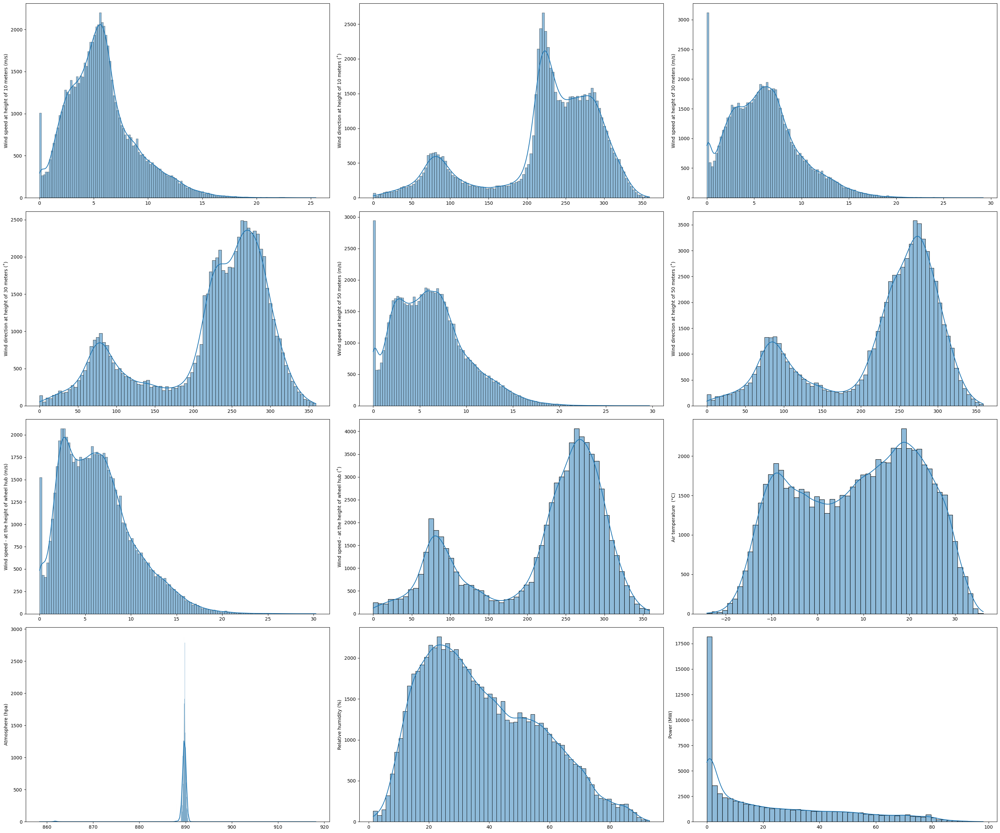

In [28]:
fig, axes = mp.subplots(nrows=4, ncols=3, figsize=(30, 25))
for idx, feat in enumerate(Dataset_WF_site1.iloc[:,1:].columns.to_list(), start=0):
    ax = axes[int(idx / 3), idx % 3]
    sns.histplot(Dataset_WF_site1[feat], kde=True, ax=ax)
    ax.set_xlabel("")
    ax.set_ylabel(feat)
fig.tight_layout();

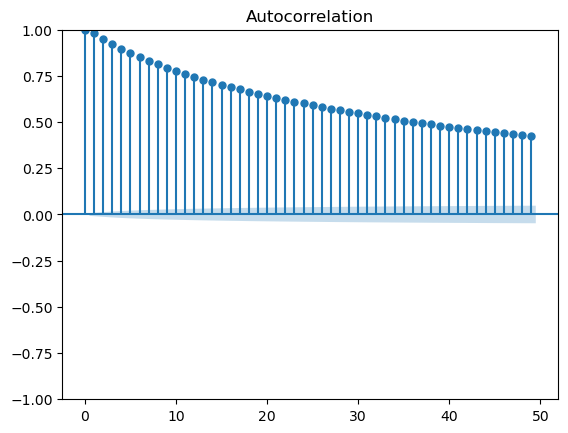

In [17]:
sm.graphics.tsa.plot_acf(Dataset_WF_site1['Power (MW)']);

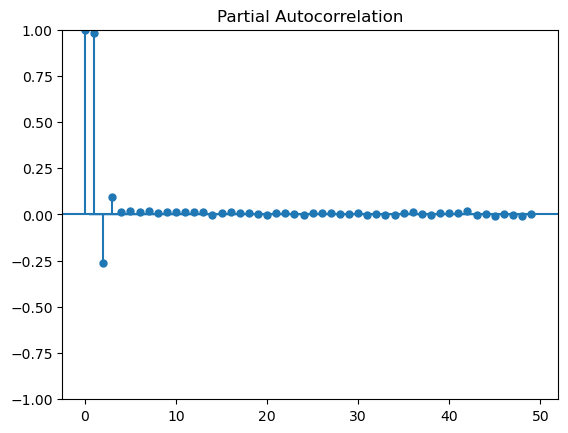

In [18]:
sm.graphics.tsa.plot_pacf(Dataset_WF_site1['Power (MW)']);

In [21]:
dftest = adfuller(Dataset_WF_site1['Power (MW)'])
dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
for key,value in dftest[4].items():
    dfoutput['Critical Value (%s)'%key] = value
print (dfoutput)

Test Statistic                   -19.909789
p-value                            0.000000
#Lags Used                        41.000000
Number of Observations Used    70133.000000
Critical Value (1%)               -3.430443
Critical Value (5%)               -2.861581
Critical Value (10%)              -2.566792
dtype: float64


In [53]:
train = Dataset_WF_site1.loc[Dataset_WF_site1['Time(year-month-day h:m:s)'] < '06-01-2020']
test = Dataset_WF_site1.loc[Dataset_WF_site1['Time(year-month-day h:m:s)'] >= '06-01-2020']

In [55]:
forecaster = NaiveForecaster(strategy="mean")
forecaster.fit(train['Power (MW)'].to_frame())

NaiveForecaster(strategy='mean')

In [58]:
fh = ForecastingHorizon(
pd.PeriodIndex(pd.date_range("2020-06-01 00:00:00", "2020-06-01 06:00:00", freq="15min")),
    is_relative=False
)
print(fh)

ForecastingHorizon(['2020-06-01 00:00', '2020-06-01 00:15', '2020-06-01 00:30',
             '2020-06-01 00:45', '2020-06-01 01:00', '2020-06-01 01:15',
             '2020-06-01 01:30', '2020-06-01 01:45', '2020-06-01 02:00',
             '2020-06-01 02:15', '2020-06-01 02:30', '2020-06-01 02:45',
             '2020-06-01 03:00', '2020-06-01 03:15', '2020-06-01 03:30',
             '2020-06-01 03:45', '2020-06-01 04:00', '2020-06-01 04:15',
             '2020-06-01 04:30', '2020-06-01 04:45', '2020-06-01 05:00',
             '2020-06-01 05:15', '2020-06-01 05:30', '2020-06-01 05:45',
             '2020-06-01 06:00'],
            dtype='period[15T]', is_relative=False)


In [59]:
pred = forecaster.predict(fh)
print(pred)

AssertionError: 

In [62]:
forecaster = SimpleExpSmoothing(train['Power (MW)'].to_frame())
# fittedVal = forecaster.fit()
# print(fittedVal.summary())

In [63]:
fittedVal = forecaster.fit()

IndexError: index 0 is out of bounds for axis 0 with size 0

In [27]:
def calc_err_metrics(pred):
    print("MAPE: ", mean_absolute_percentage_error(test, pred))
    print("MAE: ", mean_absolute_error(test, pred))
    print("MASE: ", mean_absolute_scaled_error(test, pred, y_train=train))
    print("MSE: ", mean_squared_error(test,pred))
    rmse = MeanSquaredError(square_root=True)
    print("RMSE: ", rmse(test, pred))